In [1]:
import sys, os
sys.path.append('..')
os.chdir('..')

import torch
import torch.nn as nn
import torch.nn.functional as F

from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt
import cv2

from emonet.models import EmoNet

In [2]:
def to_np(x: torch.Tensor) -> np.ndarray:
    return x.permute(1, 2, 0).detach().numpy()

In [3]:
def show_tensor(x: torch.Tensor, title: str="", grid_size: int=None, cmap='virdis'):
    arr = x.detach().numpy()

    if grid_size is None:
        grid_size = np.sqrt(x.shape[0]).astype('int')
    print('using grid size: {}x{}'.format(x.shape[0], x.shape[0]))

    fig, ax = plt.subplots(nrows=grid_size, ncols=grid_size, figsize=[grid_size*2]*2)
    plt.suptitle("Result after first conv2d", fontsize=18)
    for idx, axis in enumerate(ax.flatten()):
        axis.imshow(arr[idx], cmap=cmap)
    plt.show()

In [4]:
# load params
state = torch.load("pretrained/emonet_8.pth", map_location="cpu")
state = { k.replace("module.", ""): v for k, v in state.items() }

model = EmoNet(n_expression=8)
model.load_state_dict(state)
modules = list(model._modules.keys())
len(modules)

21

In [5]:
# TEST: print modules
# model._modules['conv1']
for idx, name in enumerate(modules):
    tensor = model._modules[name]
    print(' {:>3} :  {:<20} {:<50} {}'.format(idx+1, name, str(type(tensor)), isinstance(tensor, nn.Conv2d)))
    # print(tensor._parameters)
    # break

   1 :  conv1                <class 'torch.nn.modules.conv.Conv2d'>             True
   2 :  bn1                  <class 'torch.nn.modules.batchnorm.BatchNorm2d'>   False
   3 :  conv2                <class 'emonet.models.emonet.ConvBlock'>           False
   4 :  conv3                <class 'emonet.models.emonet.ConvBlock'>           False
   5 :  conv4                <class 'emonet.models.emonet.ConvBlock'>           False
   6 :  m0                   <class 'emonet.models.emonet.HourGlass'>           False
   7 :  top_m_0              <class 'emonet.models.emonet.ConvBlock'>           False
   8 :  conv_last0           <class 'torch.nn.modules.conv.Conv2d'>             True
   9 :  bn_end0              <class 'torch.nn.modules.batchnorm.BatchNorm2d'>   False
  10 :  l0                   <class 'torch.nn.modules.conv.Conv2d'>             True
  11 :  bl0                  <class 'torch.nn.modules.conv.Conv2d'>             True
  12 :  al0                  <class 'torch.nn.modules.conv

In [11]:
# load image as tensor
img_path = Path("media/images/example.png")
bgr = cv2.imread(str(img_path))
bgr = cv2.resize(bgr, (256, 256))
rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
x = (torch.from_numpy(rgb).permute(2, 0, 1).float() / 255.0).unsqueeze(0)
x.shape

torch.Size([1, 3, 256, 256])

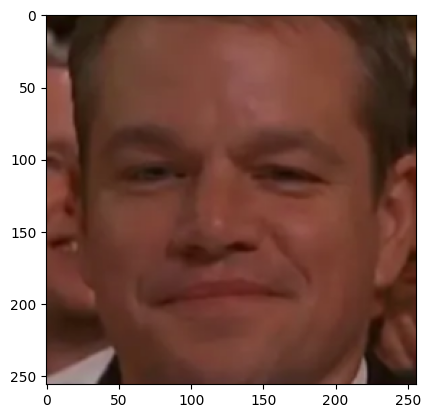

In [7]:
# show initial image
plt.imshow(to_np(x[0]))
plt.show()

In [ ]:
# evaluate whole model
model.eval()
with torch.no_grad():
    out = model(x)
out

{'heatmap': tensor([[[[ 4.9502e-05,  2.5309e-05,  4.6430e-05,  ...,  4.3604e-05,
             1.2761e-05,  2.6419e-04],
           [ 6.9273e-05,  2.3368e-05,  3.3033e-05,  ...,  5.4094e-05,
             8.5029e-06, -2.9337e-05],
           [ 1.6378e-05,  1.0400e-05,  2.1293e-05,  ...,  1.0322e-05,
            -2.8293e-05, -5.0995e-05],
           ...,
           [ 5.4667e-05,  6.7181e-05,  9.3819e-05,  ...,  4.5859e-05,
             5.9952e-05,  1.9864e-05],
           [ 6.2377e-05,  6.6367e-05,  7.8691e-05,  ...,  7.7137e-05,
             6.6941e-05,  2.3565e-05],
           [ 3.9263e-05,  7.5819e-05,  8.5664e-05,  ...,  3.7783e-05,
             3.0617e-05,  1.8099e-06]],
 
          [[ 1.5432e-04,  1.5593e-04,  1.6593e-04,  ...,  1.6459e-04,
             1.4999e-04, -1.4001e-04],
           [ 1.5151e-04,  1.5501e-04,  1.5959e-04,  ...,  1.6956e-04,
             1.4797e-04,  1.2998e-04],
           [ 1.4768e-04,  1.4887e-04,  1.5403e-04,  ...,  1.4486e-04,
             1.3055e-04,  1.

In [38]:
module = model._modules['conv1']
module
# nn.Conv2d()

Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3))

NAME: conv1
MODULE: Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3))
input shape:  [1, 3, 256, 256]
output shape: [1, 64, 128, 128]
using grid size: 64x64


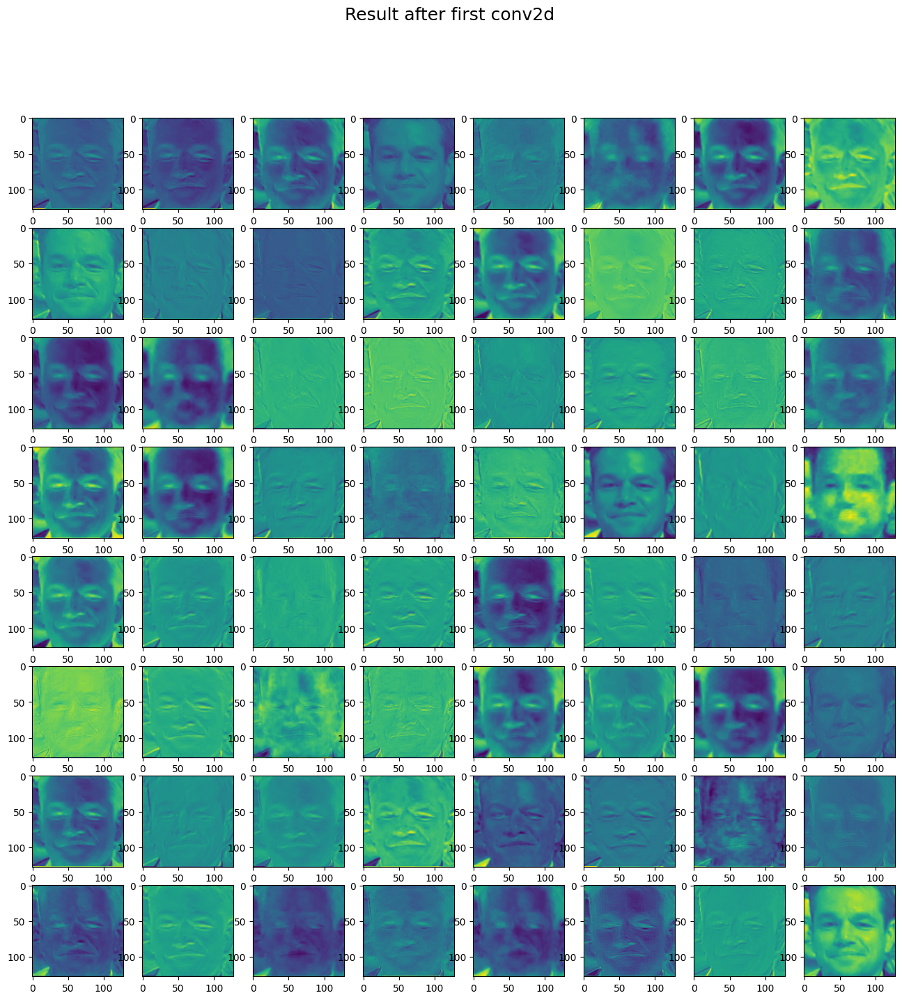

In [ ]:
# SHOW #1: 'conv1'
name = modules[0]
module = model._modules[name]
print('NAME:', name)
print('MODULE:', module)

x1 = module(x)
print('input shape: ', list(x.shape))
print('output shape:', list(x1.shape))

# plot (cmap=viridis|plasma|gray)
show_tensor(x1[0], cmap='viridis')

using grid size: 64x64


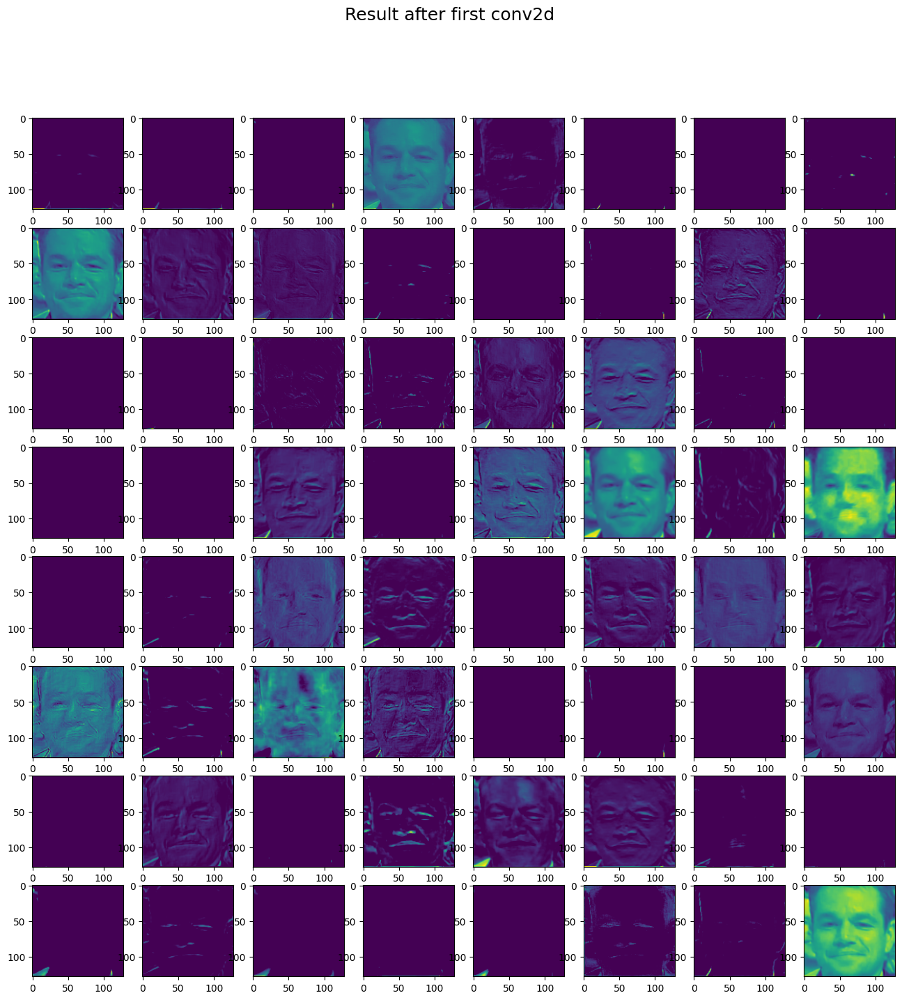

In [ ]:
# Activation function
x1 = F.relu(x1, True)
show_tensor(x1[0])

NAME: conv2
MODULE: ConvBlock(
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv2): Conv2d(64, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (bn3): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (downsample): Sequential(
    (0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
  )
)
OUT SHAPE: torch.Size([1, 128, 128, 128])
using grid size: 128x128


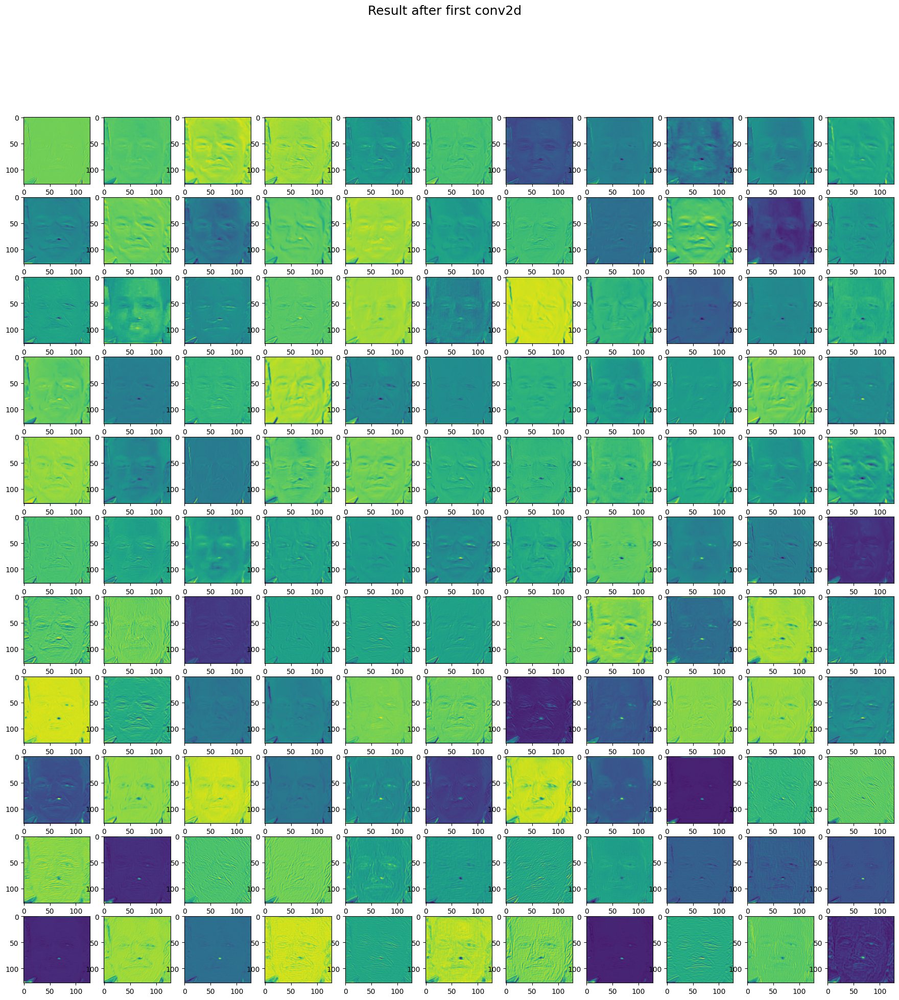

In [ ]:
# SHOW #2: ''
name = modules[2]
module = model._modules[name]
print('NAME:', name)
print('MODULE:', module)

x2 = module(x1)
print('OUT SHAPE:', x2.shape)
show_tensor(x2[0])

NAME: conv4
MODULE: ConvBlock(
  (bn1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv2): Conv2d(128, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (bn3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (downsample): Sequential(
    (0): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (1): ReLU(inplace=True)
    (2): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
  )
)
OUT SHAPE: torch.Size([1, 256, 128, 128])
using grid size: 256x256


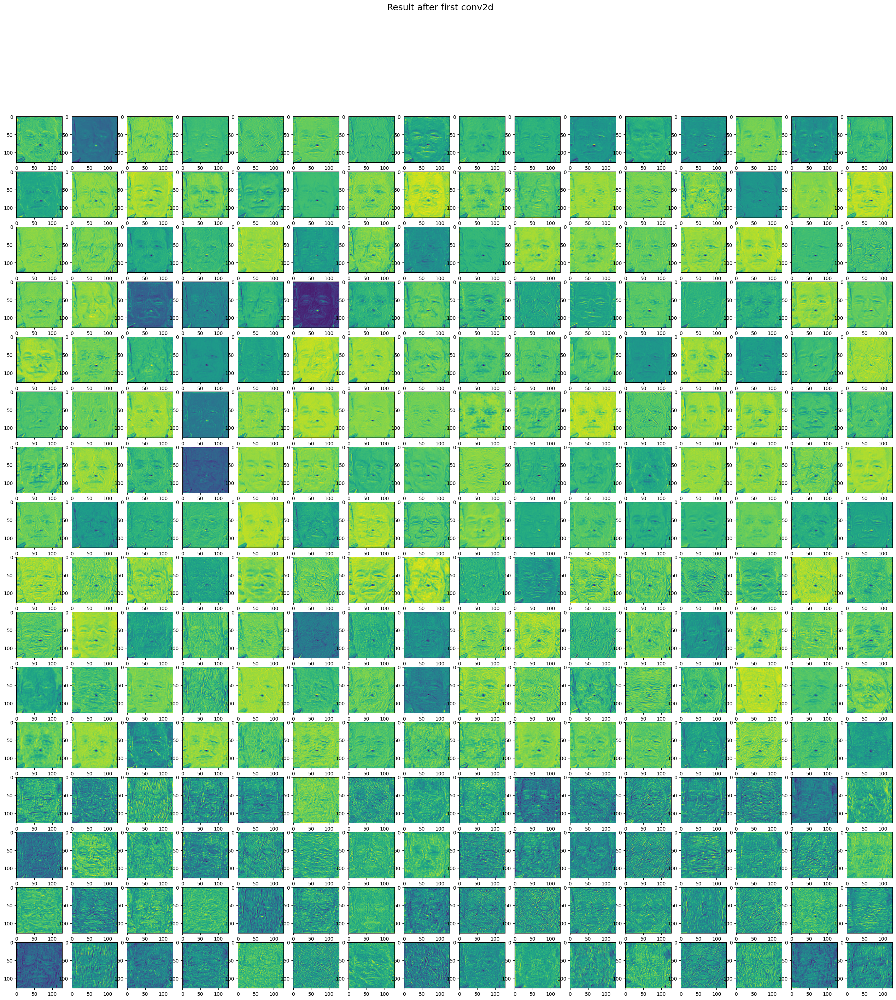

In [ ]:
# SHOW 
name = 'conv2'
module = model._modules[name]
print('NAME:', name)
print('MODULE:', module)

x3 = module(x2)
print('OUT SHAPE:', x3.shape)

# plot
show_tensor(x3[0])

using grid size: 256x256


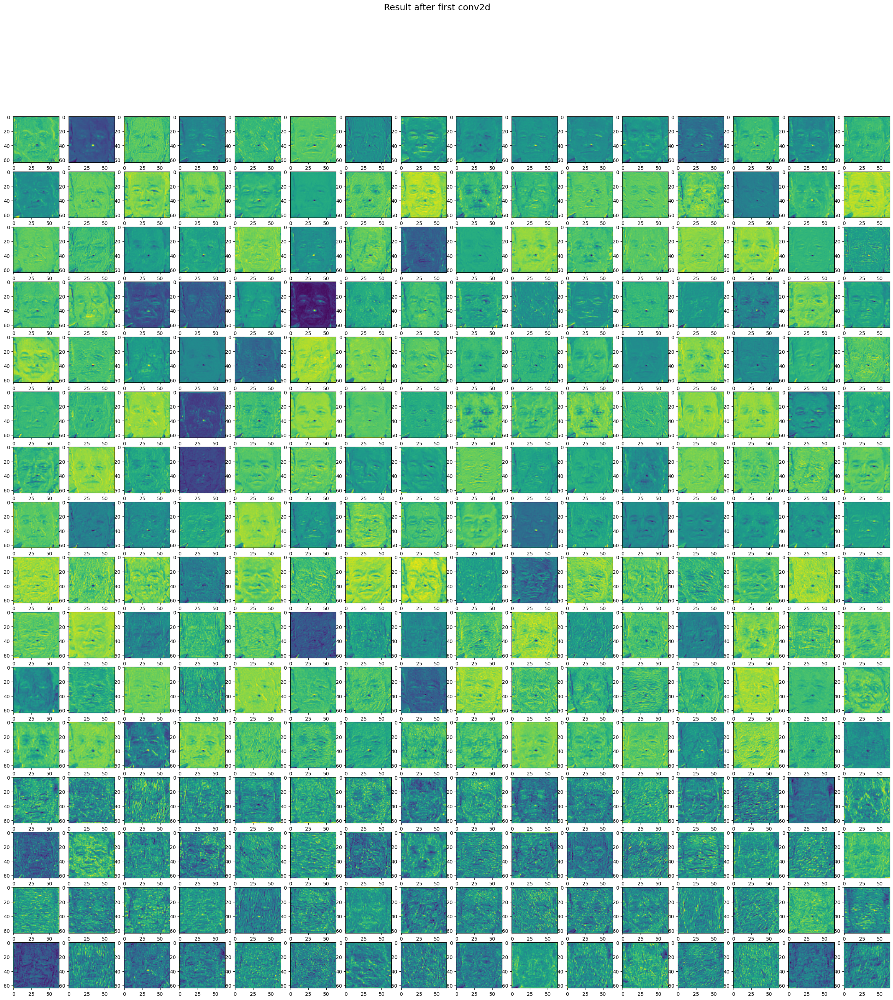

In [87]:
# Max pool
x3 = F.max_pool2d(x3, 2, stride=2)
show_tensor(x3[0])